## Chung Yu Ericson Ho

#### My primary interest for this EDA is:

- Feature Relationships: Analyzing the distribution of continuous magnitude (mag) across categorical factors like network source (net) and the engineered ordinal categories (mag_ordinal, depth_ordinal) to see if the different locations of network would have impact on the data.

- Quantitative Relationships: Quantify the relationships between numerical features the topic is interested in, such as `magnitude`, `depth`,`latitidue`, `longitdue`, `network sorce`,`magnitude ordinal` and `depth ordinal`.

- Spatial Distribution: Mapping earthquake epicenters, particularly identifying regions prone to high-magnitude or deep events.

In [1]:
import pandas as pd
import altair as alt
import numpy as np
import altair as alt
alt.renderers.enable("mimetype")
alt.data_transformers.enable("vegafusion")

DataTransformerRegistry.enable('vegafusion')

In [2]:
df = pd.read_csv("../../data/processed/ordinal_data.csv")

In [3]:
df.head()

,time,latitude,longitude,depth,mag,magType,nst,gap,dmin,rms,...,horizontalError,depthError,magError,magNst,status,locationSource,magSource,mag_ordinal,depth_ordinal,gap_level
0,2025-10-23T22:11:40.587Z,32.274000,-101.931000,4.2122,1.40,ml,40.0,40.0,0.000000,0.50,...,0.00,0.813793,0.20,25.0,automatic,tx,tx,Minor (<4.0),Shallow (0-70 km),high
1,2025-10-23T22:09:24.260Z,38.806835,-122.751999,-0.6400,1.27,md,13.0,110.0,0.023310,0.04,...,0.25,0.730000,0.21,13.0,automatic,nc,nc,Minor (<4.0),Negative (<0 km),moderate-low
2,2025-10-23T22:08:01.540Z,38.807835,-122.751167,0.1900,1.24,md,12.0,112.0,0.023690,0.02,...,0.23,1.030000,0.21,12.0,automatic,nc,nc,Minor (<4.0),Shallow (0-70 km),moderate-low
3,2025-10-23T22:07:48.630Z,38.834332,-122.796333,2.2500,0.23,md,10.0,76.0,0.006201,0.02,...,0.57,0.460000,0.11,10.0,automatic,nc,nc,Minor (<4.0),Shallow (0-70 km),moderate-high
4,2025-10-23T22:01:31.590Z,38.808998,-122.811668,3.6600,0.74,md,10.0,83.0,0.012830,0.02,...,0.40,1.180000,0.07,10.0,automatic,nc,nc,Minor (<4.0),Shallow (0-70 km),moderate-high


In [4]:
df.columns

Index(['time', 'latitude', 'longitude', 'depth', 'mag', 'magType', 'nst',
       'gap', 'dmin', 'rms', 'net', 'id', 'updated', 'place', 'type',
       'horizontalError', 'depthError', 'magError', 'magNst', 'status',
       'locationSource', 'magSource', 'mag_ordinal', 'depth_ordinal',
       'gap_level'],
      dtype='object')

In [5]:
depth_order = ['Negative (<0 km)', 'Shallow (0-70 km)', 'Intermediate (70-300 km)', 'Deep (>300 km)']
gap_order = ['poor', 'moderate-low', 'moderate-high', 'high'] 
mag_order = ['Minor (<4.0)', 'Light (4.0-4.9)', 'Moderate (5.0-5.9)', 'Strong (6.0-6.9)', 'Major (>=7.0)']
core_cols = [
    'mag', 'depth', 'gap', 'latitude', 'longitude'
]


### Different Network Potential Geographic Impact On Data

We will be studying the most popular network sources and identify patterns that could be potentially caused by the location difference.

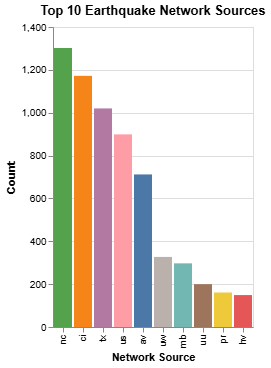

In [6]:
net_counts = df['net'].value_counts().nlargest(10).index.tolist()
net_bar = alt.Chart(df[df['net'].isin(net_counts)]).mark_bar().encode(
    alt.X("net:N", title="Network Source", sort="-y"),
    alt.Y("count()", title="Count"),
    color=alt.Color("net:N", legend=None)
).properties(title="Top 10 Earthquake Network Sources")
net_bar

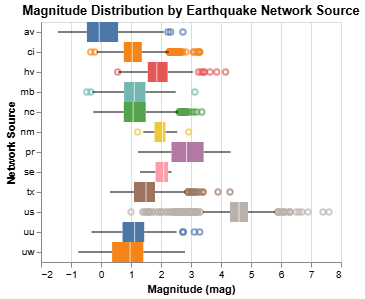

In [7]:
mag_net_boxplot = alt.Chart(df).mark_boxplot(extent=1.5, size=20).encode(
    alt.Y('net:N', title='Network Source', sort=alt.EncodingSortField(field="mag", op="median", order='descending')),
    alt.X('mag:Q', title='Magnitude (mag)'),
    alt.Color('net:N', legend=None),
    tooltip=['net', 'median(mag)', 'min(mag)', 'max(mag)']
).properties(
    title='Magnitude Distribution by Earthquake Network Source'
).interactive()
mag_net_boxplot

Despite the different locations, each network have pretty similar and consistent results, with US being the exception. Our interpretation is US is likely recording the most earthquakes around the world and that could contribute to more outliers.

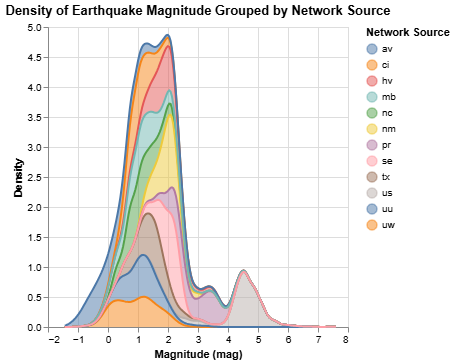

In [8]:
net_density_chart = alt.Chart(df).transform_density(
    'mag',
    groupby=['net'],  
    as_=['mag', 'density']
).mark_area(
    opacity=0.5,
    line={'color':'darkgrey'}
).encode(
    x=alt.X('mag:Q', title='Magnitude (mag)'),
    y=alt.Y('density:Q', title='Density'),  # Force quantitative
    color=alt.Color('net:N', title='Network Source'),
    tooltip=[alt.Tooltip('net:N'), alt.Tooltip('mag:Q'), alt.Tooltip('density:Q')]
).properties(
    title='Density of Earthquake Magnitude Grouped by Network Source'
)

net_density_chart

The graph clearly separates the goals of the seismic networks:

- High-Density Regional Networks: ('ci', 'hv', 'nc', etc.) prioritize detection completeness and high resolution for small-to-micro earthquakes to study local fault mechanics.

- Broad-Scope Global Network: ('us') prioritizes breadth of coverage and the reliable recording of moderate-to-large events that pose a hazard.

### Geolocation of Earthquakes 

The following graphs are a collection basic bar charts of the frequency  of earthquakes in relation to the respective attributes of interest:

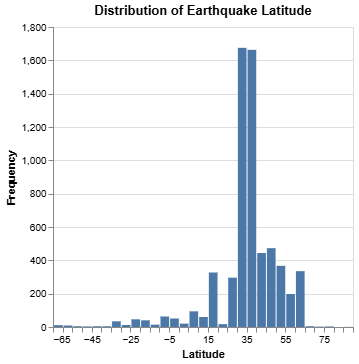

In [9]:
lat_hist = alt.Chart(df).mark_bar().encode(
    alt.X("latitude:Q", bin=alt.Bin(maxbins=50), title="Latitude"),
    alt.Y("count()", title="Frequency")
).properties(title="Distribution of Earthquake Latitude")
lat_hist

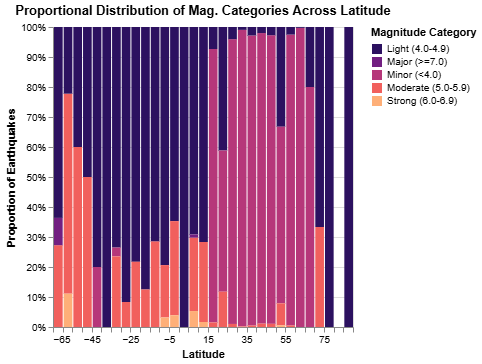

In [10]:
lat_proportional_hist = alt.Chart(df).mark_bar(
    strokeWidth=0,
    stroke=None
).encode(
    alt.X("latitude:Q", bin=alt.Bin(maxbins=30), title="Latitude"),
    alt.Y("count()", stack="normalize", title="Proportion of Earthquakes"),
    alt.Color("mag_ordinal:O", title="Magnitude Category", 
              scale=alt.Scale(scheme='magma')),  
    tooltip=[
        alt.Tooltip('latitude:Q', bin=True, title='Latitude Bin'),
        alt.Tooltip('mag_ordinal:O', title='Magnitude Category'),
        alt.Tooltip('count():Q', title='Count'),
    ]
).properties(
    title="Proportional Distribution of Mag. Categories Across Latitude"
)

lat_proportional_hist

The chart visually demonstrates that while small earthquakes occur everywhere, the most severe seismic hazard, represented by the proportion of Strong and Major quakes, is highly concentrated geographically, particularly at the extremes of the sampled latitude range (high northern and high southern latitudes), corresponding to major plate boundaries like the Circum-Pacific Belt.

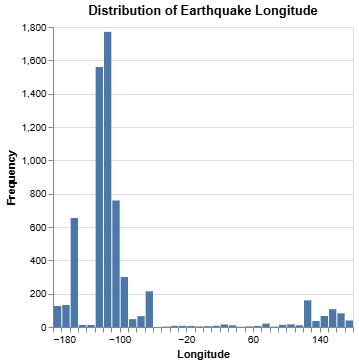

In [11]:
lon_hist = alt.Chart(df).mark_bar().encode(
    alt.X("longitude:Q", bin=alt.Bin(maxbins=50), title="Longitude"),
    alt.Y("count()", title="Frequency")
).properties(title="Distribution of Earthquake Longitude")
lon_hist

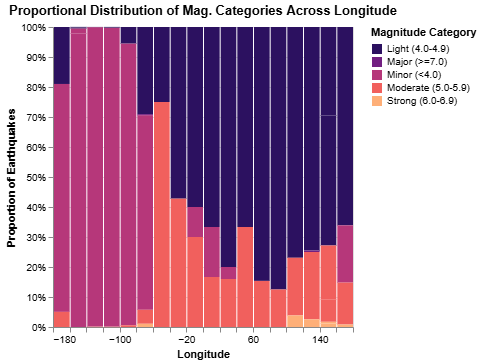

In [12]:
lon_proportional_hist = alt.Chart(df).mark_bar(
    strokeWidth=0,
    stroke=None
).encode(
    alt.X("longitude:Q", bin=alt.Bin(maxbins=30), title="Longitude"),
    alt.Y("count()", stack="normalize", title="Proportion of Earthquakes"),
    alt.Color("mag_ordinal:O", title="Magnitude Category", 
              scale=alt.Scale(scheme='magma')),  
    tooltip=[
        alt.Tooltip('longitude:Q', bin=True, title='Longitude Bin'),
        alt.Tooltip('mag_ordinal:O', title='Magnitude Category'),
        alt.Tooltip('count():Q', title='Count'),
    ]
).properties(
    title="Proportional Distribution of Mag. Categories Across Longitude"
)

lon_proportional_hist

The chart graphically demonstrates that the seismic hazard (the relative proportion of larger, potentially damaging quakes) is concentrated along the Pacific margins (the Ring of Fire), particularly in the Western Hemisphere longitudes, while activity elsewhere is dominated by small, non-destructive events.

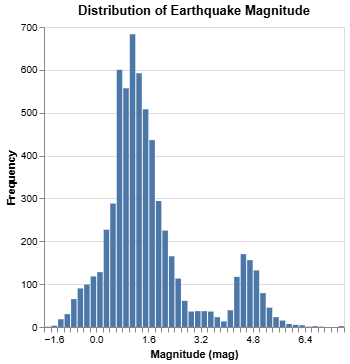

In [13]:
mag_hist = alt.Chart(df).mark_bar().encode(
    alt.X("mag:Q", bin=alt.Bin(maxbins=50), title="Magnitude (mag)"),
    alt.Y("count()", title="Frequency")
).properties(title="Distribution of Earthquake Magnitude")
mag_hist

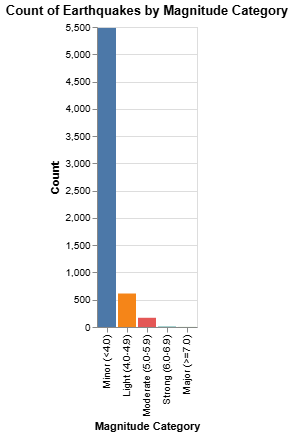

In [14]:
mag_ordinal_bar = alt.Chart(df).mark_bar().encode(
    alt.X("mag_ordinal:N", sort=mag_order, title="Magnitude Category"),
    alt.Y("count()", title="Count"),
    color=alt.Color("mag_ordinal:N", sort=mag_order, legend=None)
).properties(title="Count of Earthquakes by Magnitude Category")
mag_ordinal_bar

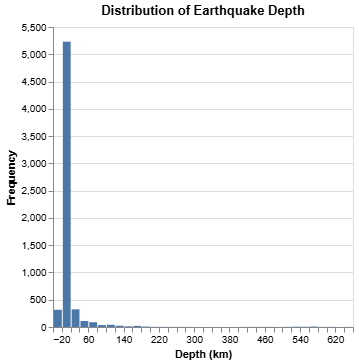

In [15]:
depth_hist = alt.Chart(df).mark_bar().encode(
    alt.X("depth:Q", bin=alt.Bin(maxbins=50), title="Depth (km)"),
    alt.Y("count()", title="Frequency")
).properties(title="Distribution of Earthquake Depth")
depth_hist

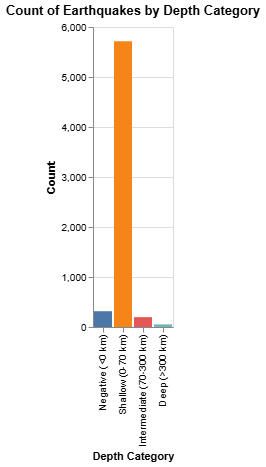

In [16]:
depth_ordinal_bar = alt.Chart(df).mark_bar().encode(
    alt.X("depth_ordinal:N", sort=depth_order, title="Depth Category"),
    alt.Y("count()", title="Count"),
    color=alt.Color("depth_ordinal:N", sort=depth_order, legend=None)
).properties(title="Count of Earthquakes by Depth Category")
depth_ordinal_bar

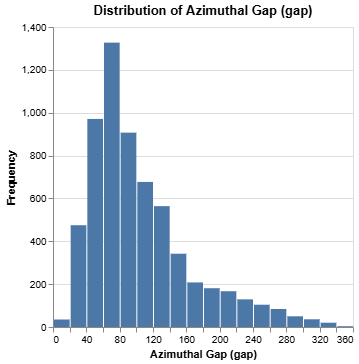

In [17]:
gap_hist = alt.Chart(df).mark_bar().encode(
    alt.X("gap:Q", bin=alt.Bin(maxbins=30), title="Azimuthal Gap (gap)"),
    alt.Y("count()", title="Frequency")
).properties(title="Distribution of Azimuthal Gap (gap)")
gap_hist

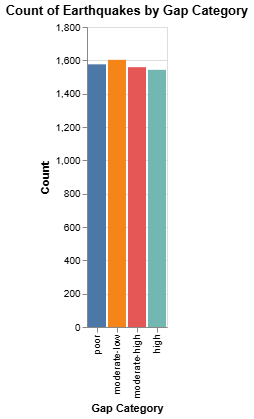

In [18]:
depth_ordinal_bar = alt.Chart(df).mark_bar().encode(
    alt.X("gap_level:N", sort=gap_order, title="Gap Category"),
    alt.Y("count()", title="Count"),
    color=alt.Color("gap_level:N", sort=gap_order, legend=None)
).properties(title="Count of Earthquakes by Gap Category")
depth_ordinal_bar

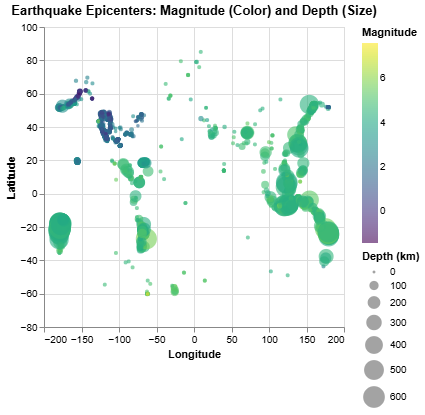

In [19]:
spatial_map = alt.Chart(df).mark_circle(opacity=0.6).encode(
    alt.X('longitude:Q', title='Longitude'),
    alt.Y('latitude:Q', title='Latitude'),
    alt.Color('mag:Q', scale=alt.Scale(scheme='viridis', domain=[df['mag'].min(), df['mag'].max()]), title='Magnitude'),
    alt.Size('depth:Q', scale=alt.Scale(range=[5, 500], domain=[df['depth'].min(), df['depth'].max()]), title='Depth (km)'),
    tooltip=['place', 'mag', 'depth', 'mag_ordinal']
).properties(
    title='Earthquake Epicenters: Magnitude (Color) and Depth (Size)'
)
spatial_map

- Circum-Pacific Belt (Ring of Fire): The most striking feature is the dense clustering of earthquakes along the edges of the Pacific Ocean (roughly Longitude -180 to -70 and 100 to 180). This region is the famous "Ring of Fire," where the majority of the world's large, shallow, and deep earthquakes occur, primarily due to subduction zones.

- Absence in Continental Interiors: There are very few epicenters in the centers of major continental landmasses (e.g., central Africa, central North America, central South America, central Eurasia), confirming that most significant seismicity occurs at plate boundaries.

- Mid-Ocean Ridges: A scattered, linear pattern of small, shallow earthquakes is visible in the middle of the Atlantic Ocean and the southern Pacific (e.g., near Longitude -10, 0, and 100). These correspond to mid-ocean ridges (divergent boundaries), which typically produce many small, shallow quakes.

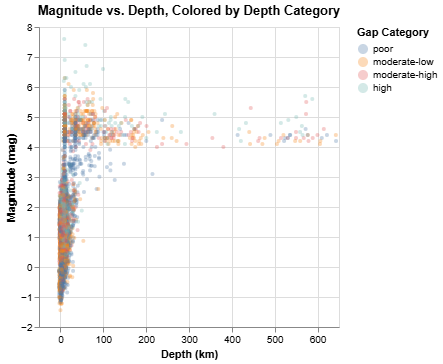

In [20]:
mag_depth_scatter = alt.Chart(df).mark_circle(size=15, opacity=0.3).encode(
    alt.X('depth:Q', title='Depth (km)'),
    alt.Y('mag:Q', title='Magnitude (mag)'),
    alt.Color('gap_level:N', sort=gap_order, title='Gap Category'),
    tooltip=['depth', 'mag', 'depth_ordinal']
).properties(
    title='Magnitude vs. Depth, Colored by Depth Category'
)
mag_depth_scatter

The overwhelming majority of the data points are clustered between 0 km and 100 km depth. The density of points drops off dramatically after 100 km.

This confirms that most earthquakes, regardless of magnitude, occur in the Earth's brittle upper crust and lithosphere where rocks are cold and rigid enough to store and release elastic strain energy. This is a fundamental concept in seismology.

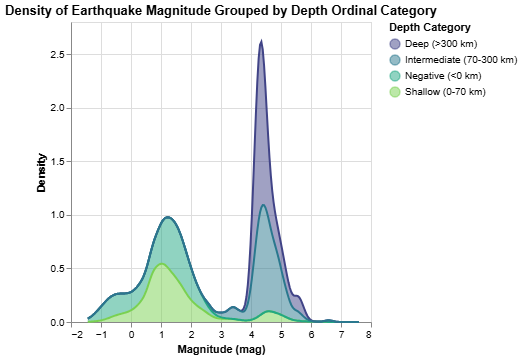

In [21]:
depth_density_chart = alt.Chart(df).transform_density(
    'mag',
    groupby=['depth_ordinal'],
    as_=['mag', 'density']
).mark_area(
    opacity=0.5,
    line={'color':'darkgrey'}
).encode(
    x=alt.X('mag:Q', title='Magnitude (mag)'),
    y=alt.Y('density:Q', title='Density'),
    
    color=alt.Color('depth_ordinal:N', title='Depth Category', scale=alt.Scale(scheme='viridis')),
    
    tooltip=[
        alt.Tooltip('depth_ordinal:N', title='Depth Category'),
        alt.Tooltip('mag:Q', title='Magnitude'),
        alt.Tooltip('density:Q', title='Density')
    ]
).properties(
    title='Density of Earthquake Magnitude Grouped by Depth Ordinal Category'
)

depth_density_chart


#### 1. Shallow (0-70 km)
Distribution: This category (light green) has a bimodal distribution.

It has a large peak at low magnitudes, roughly M≈1.5, representing the vast number of small, local crustal earthquakes.

It has a smaller, but significant, peak centered around M≈4.5, representing the moderate-to-large shallow earthquakes.

Significance: Because it encompasses the Earth's brittle crust, the Shallow category covers the fullest range of magnitudes from negative values up to M≈7.5. Shallow earthquakes are the most destructive.

#### 2. Deep (≥300 km)
Distribution: The Deep category (dark blue/purple) shows a remarkably narrow and highly peaked distribution centered sharply around M≈4.5.

Significance:

The peak is the highest of all categories, meaning that when a deep earthquake does occur, its magnitude is very likely to be close to M4.5.

There are no micro-earthquakes (M < 2) and the maximum magnitude is lower (barely reaching M 6). This confirms the geophysical constraint that very large earthquakes cannot happen at great depths due to high heat and pressure making rocks less brittle.

#### 3. Intermediate (70-300 km)
Distribution: The Intermediate category (teal) mostly mirrors the Shallow distribution but is heavily weighted towards the low-magnitude peak (M≈1.5) and significantly contributes to the M≈4.5 peak.

Significance: These earthquakes occur in the subducting slab as it descends into the mantle. The distribution shows they still generate many small quakes, but their large-magnitude potential begins to drop off compared to the Shallow layer.

#### 4. Negative (< 0 km)
Distribution: This category (light gray) is the smallest overall area but confirms the existence of highly sensitive recordings. It contributes mostly to the micro-earthquake end (M<1.0), reflecting data from extremely sensitive regional networks.

Significance: Earthquakes technically cannot happen above 0 km. This category represents the highest-quality, highest-sensitivity measurements, often involving very precise techniques (like double-difference relocation) where small tremors are assigned negative magnitudes due to their calculated position relative to a reference point or depth.

In [22]:
corr_matrix_focused = df[core_cols].corr()
cor_data_focused = corr_matrix_focused.stack().reset_index()
cor_data_focused = cor_data_focused.rename(columns={
    0: 'correlation',
    'level_0': 'variable1',
    'level_1': 'variable2'
})
corr_matrix_focused

,mag,depth,gap,latitude,longitude
mag,1.000000,0.397189,-0.056169,-0.607594,0.733623
depth,0.397189,1.000000,0.001089,-0.413894,0.305163
gap,-0.056169,0.001089,1.000000,0.218426,-0.036150
latitude,-0.607594,-0.413894,0.218426,1.000000,-0.348001
longitude,0.733623,0.305163,-0.036150,-0.348001,1.000000


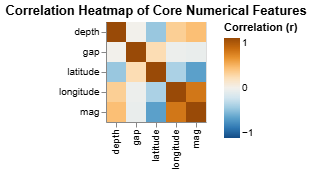

In [23]:
cor_data_focused['correlation_label'] = cor_data_focused['correlation'].map('{:.2f}'.format)

correlation_heatmap = alt.Chart(cor_data_focused).mark_rect().encode(
    alt.X('variable1:O', title=''),
    alt.Y('variable2:O', title=''),
    alt.Color('correlation', scale=alt.Scale(scheme='blueorange', domain=[-1, 1]), legend=alt.Legend(title="Correlation (r)")),
    text=alt.Text('correlation_label:N'),
    tooltip=['variable1', 'variable2', 'correlation_label']
).properties(
    title='Correlation Heatmap of Core Numerical Features'
).interactive()
correlation_heatmap 

Using latitude and longtitude as seperate attribute entry does not give a lot of insight. We therefore try a binning approach to visualize the data.

In [24]:
from vega_datasets import data

world = alt.topo_feature(data.world_110m.url, 'countries')

background_map = alt.Chart(world).mark_geoshape(
    fill='lightgray',
    stroke='white'
).project(
    "equirectangular"
).properties(
    width=700,
    height=400
)


In [25]:
import pandas as pd
import numpy as np

lon_step = 40   # wider grid blocks
lat_step = 20

lon_edges = np.arange(-180, 180, lon_step)
lat_edges = np.arange(-90, 90, lat_step)

grid = pd.DataFrame([
    {
        "lon_start": lon,
        "lon_end": lon + lon_step,
        "lat_start": lat,
        "lat_end": lat + lat_step
    }
    for lon in lon_edges
    for lat in lat_edges
])

grid_chart = alt.Chart(grid).mark_rect(
    fill='steelblue',
    fillOpacity=0.15,
    stroke='darkblue',
    strokeWidth=1
).encode(
    x='lon_start:Q',
    x2='lon_end:Q',
    y='lat_start:Q',
    y2='lat_end:Q',
    tooltip=['lon_start', 'lon_end', 'lat_start', 'lat_end']
).project(
    type="equirectangular"  # same projection as map
)


The following is the grid we created for the binning approach:

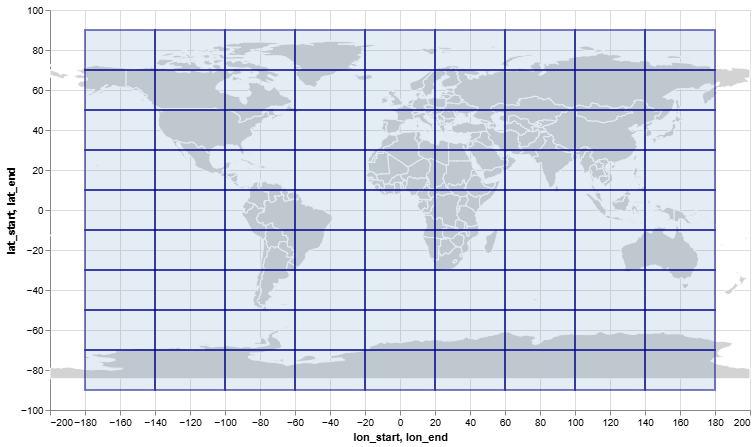

In [26]:
map_with_grid = background_map + grid_chart
map_with_grid

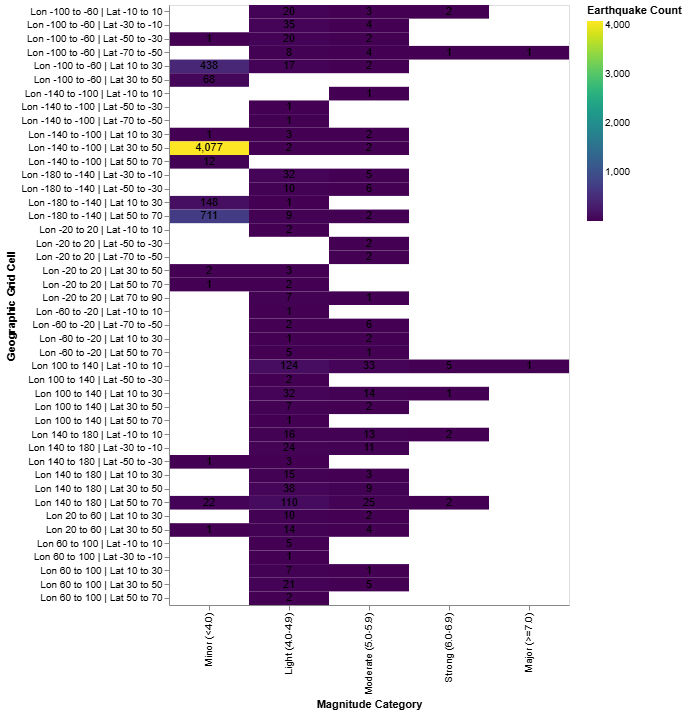

In [27]:
lon_step = 40
lat_step = 20

df['lon_bin'] = np.floor((df['longitude'] + 180) / lon_step) * lon_step - 180
df['lat_bin'] = np.floor((df['latitude'] + 90) / lat_step) * lat_step - 90

df['grid_label'] = (
    'Lon ' + df['lon_bin'].astype(int).astype(str) +
    ' to ' + (df['lon_bin'] + lon_step).astype(int).astype(str) +
    ' | Lat ' + df['lat_bin'].astype(int).astype(str) +
    ' to ' + (df['lat_bin'] + lat_step).astype(int).astype(str)
)

def categorize_magnitude(m):
    if m < 4.0:
        return 'Minor (<4.0)'
    elif m < 5.0:
        return 'Light (4.0-4.9)'
    elif m < 6.0:
        return 'Moderate (5.0-5.9)'
    elif m < 7.0:
        return 'Strong (6.0-6.9)'
    else:
        return 'Major (>=7.0)'

df['mag_ordinal'] = df['mag'].apply(categorize_magnitude)
mag_order = ['Minor (<4.0)', 'Light (4.0-4.9)', 'Moderate (5.0-5.9)', 'Strong (6.0-6.9)', 'Major (>=7.0)']

grid_summary = (
    df.groupby(['grid_label', 'mag_ordinal'])
    .size()
    .reset_index(name='count')
)

heatmap = alt.Chart(grid_summary).mark_rect().encode(
    x=alt.X('mag_ordinal:O', sort=mag_order, title='Magnitude Category'),
    y=alt.Y('grid_label:N', title='Geographic Grid Cell'),
    color=alt.Color('count:Q', scale=alt.Scale(scheme='viridis'), title='Earthquake Count'),
    tooltip=['grid_label', 'mag_ordinal', alt.Tooltip('count:Q', title='Count')]
)

text = heatmap.mark_text().encode(
    text=alt.Text('count:Q', format=',.0f'),
    color=alt.value('black')
)

final_heatmap_grid = (heatmap + text).properties(width=400, height=600)
final_heatmap_grid


High Sensitivity vs. True Activity: The cell Lon -140 to -100, Lat 30 to 50 (4,077 minor quakes) has the highest count. This is a region (like California) with high tectonic activity and an extremely dense seismic network, allowing for the detection of many more minor quakes compared to less instrumented regions.

Relative Hazard: While the overall counts are dominated by Minor quakes, the cells with the most quakes in the Moderate (5.0-5.9) and Strong (6.0-6.9) categories (e.g., Lon 100-140) indicate the areas with the highest frequency of potentially damaging events.

### High-Fidelity Sketches Attempts

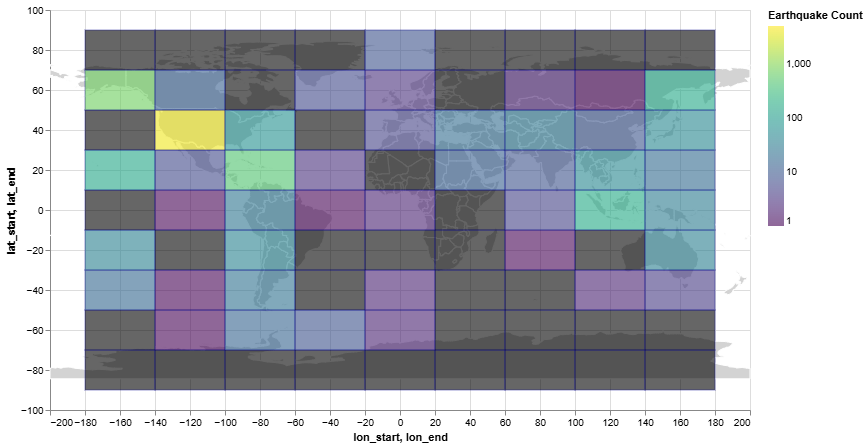

In [28]:
lon_step = 40 
lat_step = 20

lon_edges = np.arange(-180, 180, lon_step)
lat_edges = np.arange(-90, 90, lat_step)

grid = pd.DataFrame([
    {
        "lon_start": lon,
        "lon_end": lon + lon_step,
        "lat_start": lat,
        "lat_end": lat + lat_step
    }
    for lon in lon_edges
    for lat in lat_edges
])

df['lon_bin'] = np.floor((df['longitude'] + 180) / lon_step) * lon_step - 180
df['lat_bin'] = np.floor((df['latitude'] + 90) / lat_step) * lat_step - 90

count_summary = (
    df.groupby(['lon_bin', 'lat_bin'])
    .size()
    .reset_index(name='count')
)

grid_with_counts = pd.merge(
    grid,
    count_summary,
    left_on=['lon_start', 'lat_start'], # These are the bin start values
    right_on=['lon_bin', 'lat_bin'],
    how='left'
).drop(columns=['lon_bin', 'lat_bin'])

grid_with_counts['count'] = grid_with_counts['count'].fillna(0)

geo_heatmap_final = alt.Chart(grid_with_counts).mark_rect(
    stroke='darkblue',
    strokeWidth=0.5,
    opacity=0.6  
).encode(
    x='lon_start:Q',
    x2='lon_end:Q',
    y='lat_start:Q',
    y2='lat_end:Q',
    color=alt.Color('count:Q', scale=alt.Scale(scheme='viridis',type="log", domain=[1, 5000]), legend=alt.Legend(title="Earthquake Count")),
    tooltip=[
        'lon_start', 'lon_end', 'lat_start', 'lat_end',
        alt.Tooltip('count:Q', format=',.0f', title='Count')
    ]
).project(
    type="equirectangular" 
)

map_with_heatmap_overlay = background_map + geo_heatmap_final

map_with_heatmap_overlay

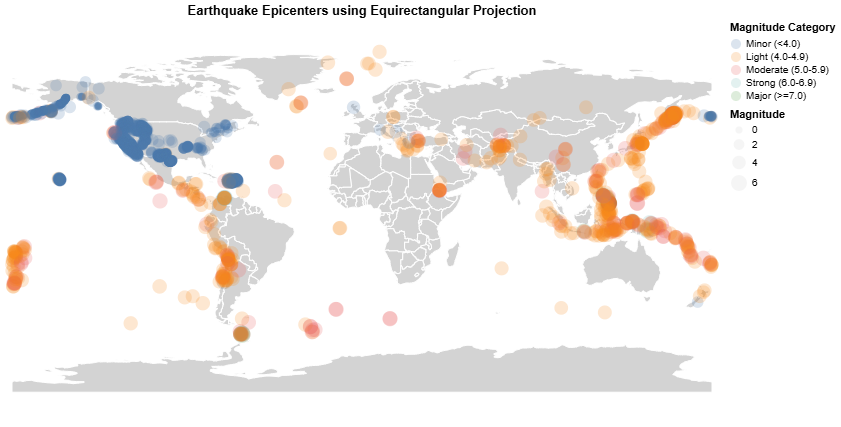

In [29]:
mag_bins = [-np.inf, 4.0, 5.0, 6.0, 7.0, np.inf]
mag_labels = ['Minor (<4.0)', 'Light (4.0-4.9)', 'Moderate (5.0-5.9)', 'Strong (6.0-6.9)', 'Major (>=7.0)']
df['mag_ordinal'] = pd.cut(df['mag'], bins=mag_bins, labels=mag_labels, right=False, ordered=True)


mag_order = ['Minor (<4.0)', 'Light (4.0-4.9)', 'Moderate (5.0-5.9)', 'Strong (6.0-6.9)', 'Major (>=7.0)']


earthquake_layer = alt.Chart(df).mark_circle(opacity=0.2).encode(
    longitude='longitude:Q',
    latitude='latitude:Q',
    
    color=alt.Color('mag_ordinal:N', sort=mag_order, title='Magnitude Category'),
    
    size=alt.Size('mag:Q', scale=alt.Scale(range=[0.5, 300]), title='Magnitude'),
    
    tooltip=['place', 'mag', 'depth', 'mag_ordinal']
)

static_map_final = (background_map + earthquake_layer).properties(
    title='Earthquake Epicenters using Equirectangular Projection'
).interactive()

static_map_final